## <center><font color=darkblue> **Traffic sign recognition and distance estimation**<font></center>

This project is inspired by [this paper](https://prints.vicos.si/publications/369).
<hr>




#  <font color=darkblue>**1. What is the Task?**<font>

The goal is to find an efficient approach using a single monocular camera to perform real-time traffic signs recognition and distance estimation between traffic sign and viewpoint.
The next thing we want to apply, after having the distance, would be a simple feedback system for the driver as a guideline.
One thing to consider is that we do not want to distract the driver by giving too much feedback, therefore, we will take the most important traffic signs which are a kind of safety feedback or an alert for the driver such as getting closer to the pedestrian path.

# <font color=darkblue>**2. Motivation**<font>

Traffic signs are an integral component of road transport infrastructure. They deliver essential driving information to road users, which in turn require them to adapt their driving behavior to road regulations.<br>
Traffic sign recognition (TSR) is a technology by which a vehicle is able to recognize the traffic signs put on the road e.g. "Give Way" or "Pedestrian Path".<br>


# <font color=darkblue>**3. Dataset**<font>
We have used the **DFG traffic sign dataset** consisting of 200 categories including a large number of traffic signs with high intra-category appearance variations.[link to the dataset](https://www.vicos.si/resources/dfg/)<br>
More precisely, Our dataset consists of 200 traffic sign categories captured in Slovenian roads spanning around 7000 high-resolution images. Images were provided and annotated by a Slovenian company DFG Consulting d.o.o. 
Additional augmentation images were created by inserting cropped instances of traffic signs into the Belgium Traffic Sign Dataset.
<br> **Note:** We add a human readable annotation as well.<br>
The RGB images were acquired with a camera mounted on a vehicle that was driven through six different Slovenian municipalities. The image data was acquired in rural as well as urban areas. Only images containing at least one traffic sign were selected from the vast corpus of collected data. Moreover, the selection was performed in such a way that there is usually a significant scene change between any pair of selected consecutive images.

## <font color=darkblue>**3.1 Evaluation Dataset**</font>
The evaluation dataset termed DFG Traffic Sign Dataset was created by focusing only on planar traffic signs with a sufficient number of samples available. Each category has at least 20 instances. Samples with a bounding box size of at least 30 pixels are tightly annotated.

# <font color=darkblue>**4. Methods**</font>
In this project, we have presented a supervised method for **recognizing trafﬁc signs** based on deep Convolutional Neural Networks (CNNs). We have used **MaskRCNN** and **Google Colaboratory**, a free environment that runs entirely in the cloud and provides a GPU.<br>
For estimating **distance** the **bird's-eye view** method is taken to account.<br>
we have tried the feedback system to become simple as possible. Thus, we have only focused on the core approach of our simulation which depends on two main things:
* knowing the distance to the traffic sign
* provide an appropriate command depending on the distance and type of the traffic sign

<br>
Later on, we will try to implement a full simulation environment as future work.


# <font color=darkblue>**5. configuration**<font>




## <font color=darkblue> **5.1. Install libraries**<font>

We faced some errors due to using the latest versions of TensorFlow, Keras, etc. So, we decided to install the older versions to get rid of the errors.


In [1]:
%%capture
!pip install scikit-image==0.16.2
!pip install h5py==2.10.0
!pip install tensorflow==1.15
!pip install tensorflow-gpu==1.15.0
!pip install keras==2.1.6 

**Note:** Since we installed new versions, we have to restart the runtime.

In [2]:
import os
import cv2
import json
import random
import requests
import warnings
import skimage.io
import numpy as np
import pandas as pd
import urllib.request 
import matplotlib.pyplot as plt
from ast import literal_eval as make_tuple
from google.colab.patches import cv2_imshow

%matplotlib inline
warnings.filterwarnings("ignore")

Because we have two different storages, depending on the condition of your choice, we have created some constants related to the project workspace.
Since we are using the drive, first, we define the related folder ("sign_detection") in the drive as our project's path. Then, we define the dataset path and annotations path based on the project path.<br>
**Note: If you work on the Colab server, alter the comment lines to uncomment and vice versa.**

In [56]:
# PROJECT_PATH = os.path.join('/content' , 'drive', 'MyDrive', 'sign_detection')
PROJECT_PATH = os.path.join('/content') #Uncomment if you work on the colab server
DATASET_PATH = os.path.join(PROJECT_PATH, 'dataset')
# ANNOTATION_PATH = os.path.join(PROJECT_PATH, 'annotation') #Uncomment if you work on the colab server
ANNOTATION_PATH = os.path.join(PROJECT_PATH, 'annotation_with_augmented')
ANNOTATION_XML_PATH = os.path.join(ANNOTATION_PATH, 'xml')
CLASS_NAMES = os.path.join(PROJECT_PATH,'traffic-sign-recognition-and-distance-estimation' ,'classnames.csv')
CLASSES = os.path.join(PROJECT_PATH,'traffic-sign-recognition-and-distance-estimation' ,'classes')


## <font color=darkblue>**5.2. Access to the Dataset**<font>
We have downloaded and uploaded the dataset to our drive. Thus, we have access to the dataset just by mounting our drive. But if you have no access to google drive, please uncomment these cells to access the dataset.

In [ ]:
# Annotation with augmented images (for ~7000 original + ~8700 augmented images)

!wget https://go.vicos.si/dfgaugannot -O annotation_with_augmented.zip
if not os.path.exists('annotation_with_augmented'):
    os.mkdir('annotation_with_augmented')
!unzip annotation_with_augmented.zip -d annotation_with_augmented
!rm annotation_with_augmented.zip

In [ ]:
# Default annotations (for ~7000 images)

!wget https://go.vicos.si/dfgannot -O annotation.zip
if not os.path.exists('annotation'):
    os.mkdir('annotation')
!unzip annotation.zip -d annotation
!rm annotation.zip

In [ ]:
# Original and augmented images

!wget https://go.vicos.si/dfgimages -O dataset.tar.bz2
!tar -xf dataset.tar.bz2
!mv JPEGImages dataset
!rm dataset.tar.bz2

## <font color=darkblue>**5.2. Fetch Mask RCNN**<font>

To work with Mask_RCNN we use the Matterport implementation of the mask RCNN. First, we clone it from Github and change our root directory to the root directory of the Matterport repository.

In [14]:
!git clone https://github.com/matterport/Mask_RCNN.git

Cloning into 'Mask_RCNN'...
remote: Enumerating objects: 956, done.
remote: Total 956 (delta 0), reused 0 (delta 0), pack-reused 956
Receiving objects: 100% (956/956), 125.23 MiB | 36.90 MiB/s, done.
Resolving deltas: 100% (565/565), done.


In [46]:
!git clone https://github.com/hassanteymoori/traffic-sign-recognition-and-distance-estimation.git

Cloning into 'traffic-sign-recognition-and-distance-estimation'...
remote: Enumerating objects: 169, done.
remote: Counting objects: 100% (169/169), done.
remote: Compressing objects: 100% (168/168), done.
remote: Total 169 (delta 1), reused 169 (delta 1), pack-reused 0
Receiving objects: 100% (169/169), 13.33 MiB | 25.13 MiB/s, done.
Resolving deltas: 100% (1/1), done.


In [47]:
os.chdir("/content/Mask_RCNN")

# <font color=darkblue>**6. Preparation**<font>
We have needed some information like annotations, class names, training images, and evaluation images. So, we will gather all this information either from our drive or from the google Colab service regarding the configuration.<br>
There is also a need for some preprocessing like providing the XML annotations.

##<font color=darkblue>**6.1. Class names**<font>

In [16]:
class_names = pd.read_csv(CLASS_NAMES, sep=";", header=0)
class_names.head(5)

,dataset,class_id,class_code,class_title,color
0,Traffic Sign,1,I-1,Bend to the left,"(0.0, 0.8199999999999998, 1.0)"
1,Traffic Sign,2,I-1.1,Bend to the right,"(0.9199999999999999, 0.0, 1.0)"
2,Traffic Sign,3,I-10,Uneven roadway,"(1.0, 0.0, 0.3600000000000003)"
3,Traffic Sign,4,I-11,Slippery roadway,"(1.0, 0.0, 0.0)"
4,Traffic Sign,5,I-13,Falling rocks on right side of the road,"(0.0, 1.0, 0.94)"


## <font color=darkblue> **6.2. Preparing training annotations**<font>
Before doing anything, we need to provide the annotation for our model.<br>


In [17]:
information = json.load(open(os.path.join(ANNOTATION_PATH, 'train.json')))

* Having categories information as a pandas dataframe

In [18]:
categories = pd.DataFrame(list(information['categories']))
categories.head(3)

,id,name,supercategory
0,0,I-1,traffic_sign
1,1,I-1.1,traffic_sign
2,2,I-10,traffic_sign


* Having trining images' information as a pandas dataframe

In [19]:
train_images = pd.DataFrame(list(information['images']))
train_images.head(3)

,id,height,width,file_name
0,0,1080,1920,0000001.jpg
1,2,1080,1920,0000003.jpg
2,3,1080,1920,0000004.jpg


* Having annotations' information for training as a pandas dataframe

In [20]:
annotations = pd.DataFrame(list(information['annotations']))
annotations.head(3)

,id,area,bbox,category_id,segmentation,image_id,ignore,iscrowd
0,0,14560,"[312, 369, 104, 140]",78,"[[357, 369, 371, 370, 383, 375, 394, 384, 402,...",0,False,0
1,1,7904,"[304, 295, 104, 76]",158,"[[307, 371, 304, 299, 405, 295, 408, 366, 307,...",0,False,0
2,2,3400,"[30, 274, 50, 68]",136,"[[77, 274, 80, 339, 33, 342, 30, 281, 77, 274]]",0,False,0


### <font color=darkblue> **6.2.1 Generating xml files for each of the training samples**<font>

We have the XML files for the training set in the drive and just load it to use. But in the case that there is no access to the drive, the below function can be used to generate the XML files.

In [21]:
import xml.etree.cElementTree as xml

if not os.path.exists(ANNOTATION_XML_PATH):
    os.mkdir(ANNOTATION_XML_PATH)

# This function is defined to generate an xml file. 
def xml_generator(df, annotation_df):
    for _, row in df.iterrows():
        filename = str(row['file_name'].split('.')[0])

        annot = xml.Element("annotation")

        xml.SubElement(annot, "folder").text = "dataset"
        xml.SubElement(annot, "path").text = f"{DATASET_PATH}/{row['file_name']}"
        source = xml.SubElement(annot, "source")

        xml.SubElement(source, 'database').text = 'Unknown'

        xml.SubElement(annot, "filename").text = f"{row['file_name']}"

        size = xml.SubElement(annot, "size")
        xml.SubElement(size, "width").text = f"{row['width']}"
        xml.SubElement(size, "height").text = f"{row['height']}"
        xml.SubElement(size, "depth").text = "3"

        xml.SubElement(annot, "segmented").text = "0"

        temp_df = annotation_df[annotation_df['image_id'] == int(row['id'])]

        for i in range(temp_df.shape[0]):
            xmin, ymin, w, h = temp_df.iloc[i, 2]

            obj = xml.SubElement(annot, "object")
            xml.SubElement(obj, "name").text = f"{temp_df.iloc[i,3]}"
            xml.SubElement(obj, "title").text = categories[categories['id']==temp_df.iloc[i,3]].iloc[0, 1]
            xml.SubElement(obj, "pose").text = "unspecified"
            xml.SubElement(obj, "truncated").text = "0"
            xml.SubElement(obj, "difficult").text = "0"
            xml.SubElement(obj, "segmentation").text = f"{temp_df.iloc[i,4]}"

            bndbox = xml.SubElement(obj, "bndbox")

            xml.SubElement(bndbox, "xmin").text = f"{xmin}"
            xml.SubElement(bndbox, "ymin").text = f"{ymin}"
            xml.SubElement(bndbox, "xmax").text = f"{xmin+w}"
            xml.SubElement(bndbox, "ymax").text = f"{ymin+h}"

        tree = xml.ElementTree(annot)
        tree.write(f"{ANNOTATION_XML_PATH}/{filename}.xml")

**Note:** Uncomment the below cell for generating the XML file if you are working on the Colab server.

In [22]:
xml_generator(train_images, annotations)

## <font color=darkblue> **6.3. Preparing test annotations**<font>
Like training we need to provide the xml annotation for our test set.

In [23]:
information_test = json.load(open(os.path.join(ANNOTATION_PATH, 'test.json')))

* Having test images' information as a pandas dataframe

In [24]:
test_images = pd.DataFrame(list(information_test['images']))
test_images.head(3)

,id,height,width,file_name
0,1,1080,1920,0000002.jpg
1,9,1080,1920,0000010.jpg
2,13,1080,1920,0000014.jpg


* Having annotations' information for test as a pandas dataframe

In [25]:
annotations_test = pd.DataFrame(list(information_test['annotations']))
annotations_test.head(3)

,id,area,bbox,category_id,segmentation,image_id,ignore,iscrowd
0,0,5796,"[299, 528, 46, 126]",186,"[[312, 654, 299, 548, 302, 529, 330, 528, 335,...",1,False,0
1,1,5256,"[277, 454, 72, 73]",74,"[[329, 457, 335, 461, 340, 465, 344, 471, 347,...",1,False,0
2,2,20088,"[1167, 2, 162, 124]",152,"[[1167, 2, 1329, 6, 1328, 126, 1167, 121, 1167...",1,False,0


<hr>

### <font color=darkblue> **6.3.1 Generating xml files for each of the test samples**<font>
There are the XML files for the test set in the drive. but you can again generate the XML files for the test set, just like the training set, using the XML generator function.
**Note:** Uncomment the below cell for generating the XML files if you are working on the Colab server.

In [26]:
xml_generator(test_images, annotations_test)

### <font color=darkblue> **6.3.2. Classes visualization**<font>
Let's have a quick look at some of the classes of the dataset

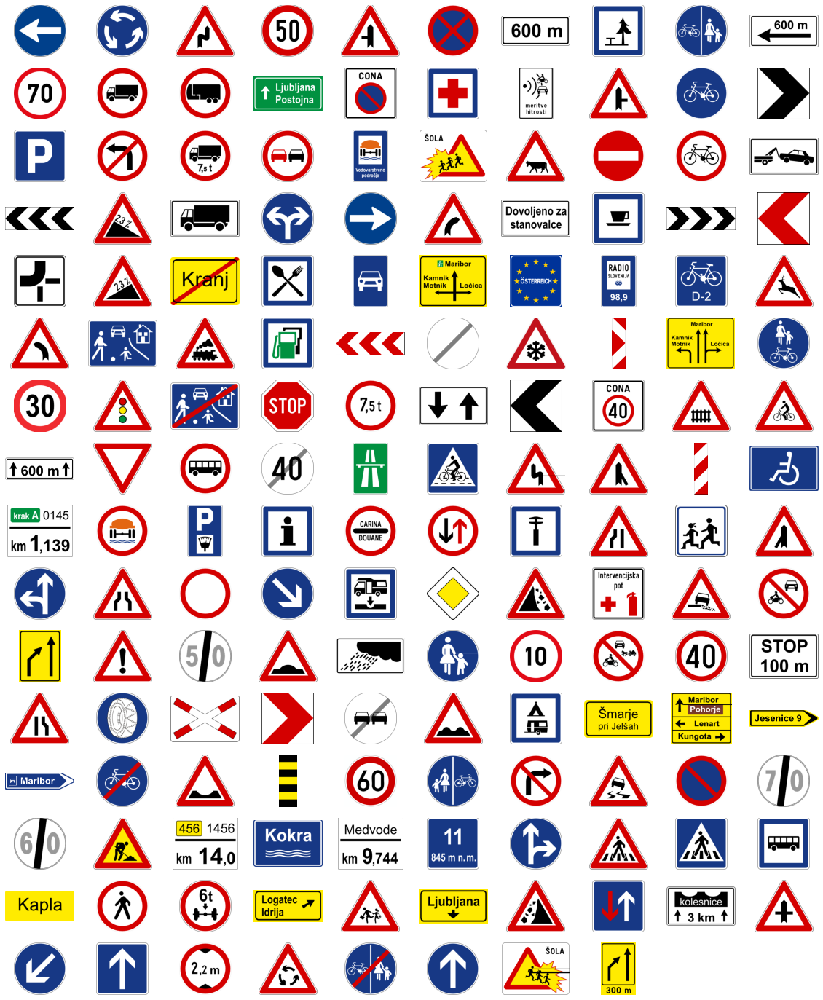

In [27]:
import glob 

fig=plt.figure(figsize=(20,25))
i, j = 0, 0

for file_path in glob.glob(os.path.join(CLASSES, '*')):
    index = i*10+j
    image = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.subplot(16, 10, index + 1) 
    plt.imshow(image)
    plt.axis('off')
    j +=1
    if j % 10 == 0:
        j =0
        i += 1
plt.show()

# <font color=darkblue> **7. Training Pipeline**<font>

In order to use Mask_RCNN, some configurations must be set based on the desired task.

* We have **200** classes which are related to different trafic signs such as stop, give way, keep right and so on.<br>
So, the overall number of classes is equal to **201**: **Background + our 200 classes**

* Additionally, required libraries from **matterport implementation** of Mask_RCNN are used.

In [28]:
class_names[class_names['class_id']==56]

,dataset,class_id,class_code,class_title,color
55,Traffic Sign,56,II-30-60,Maximum speed limit 60,"(0.0, 0.43000000000000016, 1.0)"


<font color=darkblue> **Number of Classes** <font>

In [29]:
print("Number of classes is: " , len(class_names))

Number of classes is:  200


<font color=darkblue> **Number of Training Images** <font>


In [30]:
print("Number of training images is: ", len(train_images))

Number of training images is:  14029


<font color=darkblue> **Mask_RCNN required libraries** <font>

In [31]:
import mrcnn
import mrcnn.config
import mrcnn.utils
from mrcnn import visualize
from mrcnn.config import Config
from mrcnn.utils import Dataset
from mrcnn.model import MaskRCNN
from xml.etree import ElementTree

Using TensorFlow backend.


 ## <font color=darkblue> **7.1. Preparing the Dataset**<font>
We need to create a synthetic dataset

Extend the Dataset class and add a method to load the traffic signs dataset. Something to pay attention is that, since we want to train our custom model using matterport implementation, we need to override some functions such as:

* load_image()
* load_mask()
* image_reference()

In [32]:
class RoadDataset(Dataset):

    # This function is defined to loading the dataset (Train and Test set)
    def load_dataset(self, dataset_path = DATASET_PATH, is_train=True): 
        for _, row in categories.iterrows():
            self.add_class('traffic_sign', row['id'], row['name'])

        loops = None
        if is_train:
            loops = train_images
        elif not is_train:
            loops = test_images
        for _, row in loops.iterrows():
            img_path = os.path.join(dataset_path, row['file_name'])
            filename = str(row['file_name'].split('.')[0])
            # add to dataset
            self.add_image(
                'traffic_sign', 
                image_id=row['id'], 
                path=img_path,
                width=row['width'], 
                height=row['height'],
                annotation= os.path.join(ANNOTATION_XML_PATH, f'{filename}.xml') 
                )          
    # This function is defined to extracting the bounding boxes for each traffic sign
    def extract_boxes(self, filename):
        # load and parse the file
        tree = ElementTree.parse(filename)
        # get the root of the document
        root = tree.getroot()
        # extract each bounding box and theis coordinates(xmin,xmax, ymin, ymax)
        boxes = list()
        for box in root.findall('.//object'):
            name = box.find('name').text
            title = box.find('title').text
            xmin = int(box.find('./bndbox/xmin').text)
            ymin = int(box.find('./bndbox/ymin').text)
            xmax = int(box.find('./bndbox/xmax').text)
            ymax = int(box.find('./bndbox/ymax').text)
            
            coors = [name, title, xmin, ymin, xmax, ymax]
            boxes.append(coors)
        # extract image dimensions
        width = int(root.find('.//size/width').text)
        height = int(root.find('.//size/height').text)
        return boxes, width, height

    # This function is defined to create masks for each bounding box using pre-trained Mask_RCNN
    def load_mask(self, image_id):
        # Getting details of the image
        info = self.image_info[image_id]
        # Definining the box file location
        path = info['annotation']
        # Loading XML
        boxes, w, h = self.extract_boxes(path)
        # Creating one array for all masks, each on a different channel
        masks = np.zeros([h, w, len(boxes)], dtype='uint8')
        # Creating masks
        class_ids = list()
        for i in range(len(boxes)):
            box = boxes[i]
            cls_id, class_title, x, y, x2, y2 = box 
            
            row_s, row_e = y, y2
            col_s, col_e = x, x2
            
            masks[row_s:row_e, col_s:col_e, i] = int(cls_id)

            temp_df = categories[categories['id'] == int(cls_id)]
            class_ids.append(self.class_names.index(class_title))
        return masks, np.asarray(class_ids, dtype='int32')
        
    def image_reference(self, image_id):
        info = self.image_info[image_id]
        return info['path']  


##  <font color=darkblue> **7.2. Training Configurations as **RoadConfig****<font>

The `Config` class contains the default configuration of the Matterport implementation. We need to subclass it and modify the attributes that must be changed.

We'll be using a model trained on the MS-COCO dataset. The configurations of this model are in the CocoConfig class in coco.py from the repository.

In [33]:
class RoadConfig(Config):
    """Configuration for training on the DFG dataset.
    Derives from the base Config class and overrides values specific
    to the DFG dataset.
    """

    NAME = 'road_cfg'

    # Train on 1 GPU and 1 images per GPU. We can put multiple images on each
    # GPU if the images are small. Batch size is 1 (GPUs * images/GPU).
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

    # Number of classes (including background)
    NUM_CLASSES = 1 + 200  # background + 200 signs

    STEPS_PER_EPOCH = 14029
    
config = RoadConfig()
config.display()  


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                213
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE        

##  <font color=darkblue> **7.3. Creating training and test sets**<font>
Based on the previous cells, as we override some of the functions, we have used the Roaddataset function to load and prepare our training and test sets like the following:

<font color=darkblue> **Preparing Training Set for Mask_RCNN** <font>




In [34]:
train_set = RoadDataset()
train_set.load_dataset(is_train=True)

train_set.prepare()
print('Number of Training images: %d' % len(train_set.image_ids))

Number of Training images: 14029


<font color=darkblue> **Preparing Test Set for Mask_RCNN** <font>

In [35]:
test_set = RoadDataset()
test_set.load_dataset(is_train=False)

test_set.prepare()
print('Number of Test images: %d' % len(test_set.image_ids))

Number of Test images: 1703


##  <font color=darkblue> **7.4. Defining the path of Model & COCO pre-trained Model**<font>
Matterport guys have been providing pre-trained weights for MS COCO to make it easier to start. these weights can be used as a starting point to train our own variation on the network. <br>
We have used the weights of the pre-trained **mask_rcnn_coco** model to initialize the weights for training the model.

In [36]:
MODEL_DIR = os.path.join(PROJECT_PATH, 'logs')
if not os.path.exists(MODEL_DIR):
    os.mkdir(MODEL_DIR)
COCO_MODEL_PATH = os.path.join(MODEL_DIR, 'mask_rcnn_coco.h5')

In [37]:
if not os.path.exists(COCO_MODEL_PATH):
    mrcnn.utils.download_trained_weights(COCO_MODEL_PATH)

... done downloading pretrained model!


##  <font color=darkblue> **7.5.  Training the Model on our dataset**</font>

* We have used Mask_RCNN to train the model.
* Since we are in the training phase, **mode is set to 'training'**.
* Number of epochs is set to 5. 
<br>

Train can be done in two stages:

- Only the `heads`: Here we're freezing all the backbone layers and training only the randomly initialized layers. To train only the head layers, pass layers="heads" to the train() function.

- Fine-tune `all` layers: Here we're activating all the backbone layers and training all of them. To train all layers simply pass layers="all" to train all layers.

<hr>

We will retrain all layers of the model.



In [ ]:
# model =  MaskRCNN(mode='training', model_dir= MODEL_DIR, config = config)
# model.load_weights(COCO_MODEL_PATH, by_name = True, exclude = ["mrcnn_class_logits", "mrcnn_bbox_fc",  "mrcnn_bbox", "mrcnn_mask"])
# model.train(train_set, test_set, learning_rate = config.LEARNING_RATE , epochs=5, layers = 'all') 

# <font color=darkblue> **8. Test Pipeline**<font>
The ***goal*** of this part is to **predict** with the **'Inference' Mode**.
The best model founded on the training phase (mask_rcnn_road_cfg_0005)is used in the test phase.

<font color=darkblue> **Inference Configurations and Load the model**<font>

In [38]:
class InferenceConfig(mrcnn.config.Config):
    NAME='road_cfg'
    GPU_COUNT = 1
    NUM_CLASSES = 1+200
    IMAGES_PER_GPU = 1
    DETECTION_MIN_CONFIDENCE = 0.7

inference_config = InferenceConfig()

In [57]:
model_path = '/content/drive/MyDrive/sign_detection/logs/mask_rcnn_road_cfg_0005.h5'

# Recreate the model in inference mode
model = MaskRCNN(mode="inference", config=inference_config, model_dir=model_path)

# Load trained weights
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)

Loading weights from  /content/drive/MyDrive/sign_detection/logs/mask_rcnn_road_cfg_0005.h5


##<font color=darkblue>**8.1. Some examples**</font>
We are going to show some of the examples by specifying their corresponding ground truth images.
<br>

In [58]:
# Define all the classes with background class
def class_names_bg():
    return ['BG', *class_names['class_title'].values]

# create random colors for each bounding box
def random_color(N):
    return [tuple(np.random.randint(0, 255, 3).astype(float))for i in range(N)]

# A functoin to load the images by skimage libraries
def load_image(path):
    """Load the specified image and return a [H,W,3] Numpy array.
    """
    # Load image
    image = skimage.io.imread(path)
    # If grayscale. Convert to RGB for consistency.
    if image.ndim != 3:
        image = skimage.color.gray2rgb(image)
    # If has an alpha channel, remove it for consistency
    if image.shape[-1] == 4:
        image = image[..., :3]
    return image

<hr/>

<font color=purple>**test_image_id=0** (Ground_truth): <font>

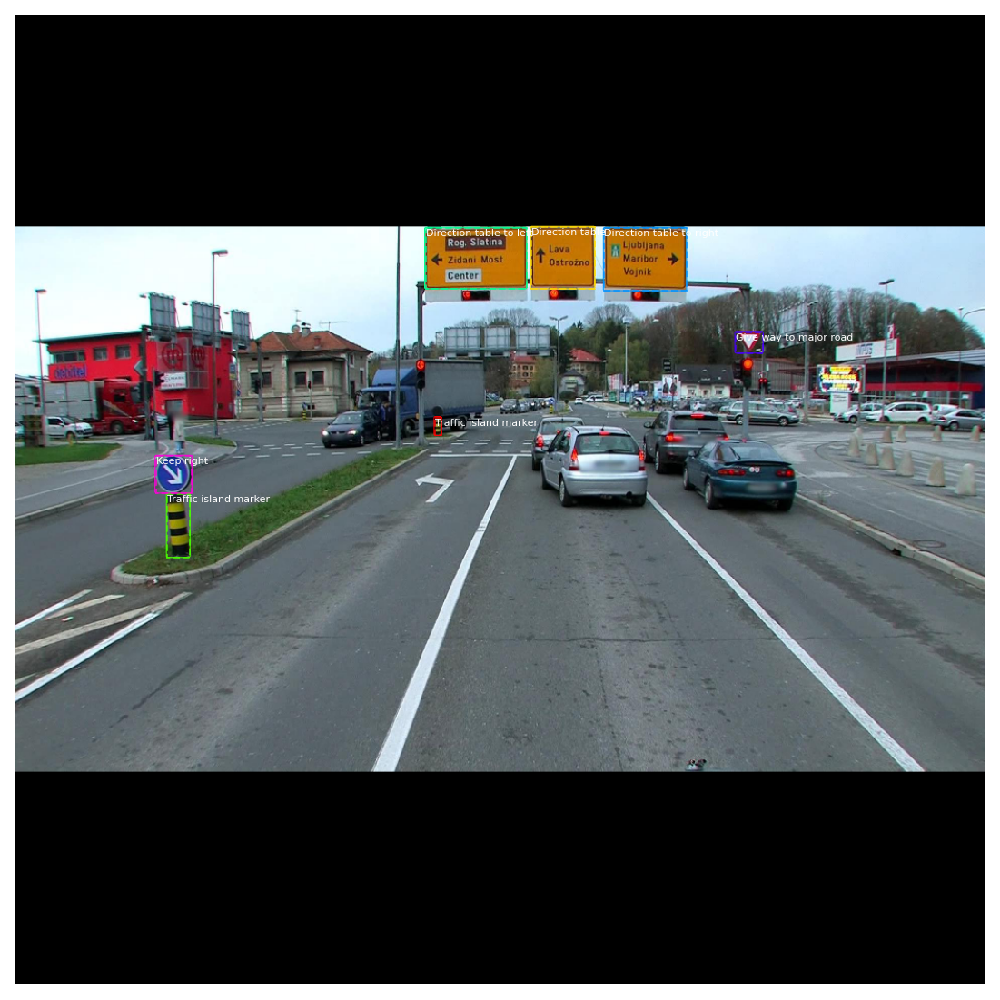

In [59]:
image_id = 0
image, image_meta, gt_class_id, gt_bbox, gt_mask = mrcnn.model.load_image_gt(test_set, inference_config, image_id)

visualize.display_instances(image, gt_bbox, gt_mask, gt_class_id, class_names_bg(),figsize=(20, 20))

<font color=Green>**test_image_id=0** (Prediction): <font>

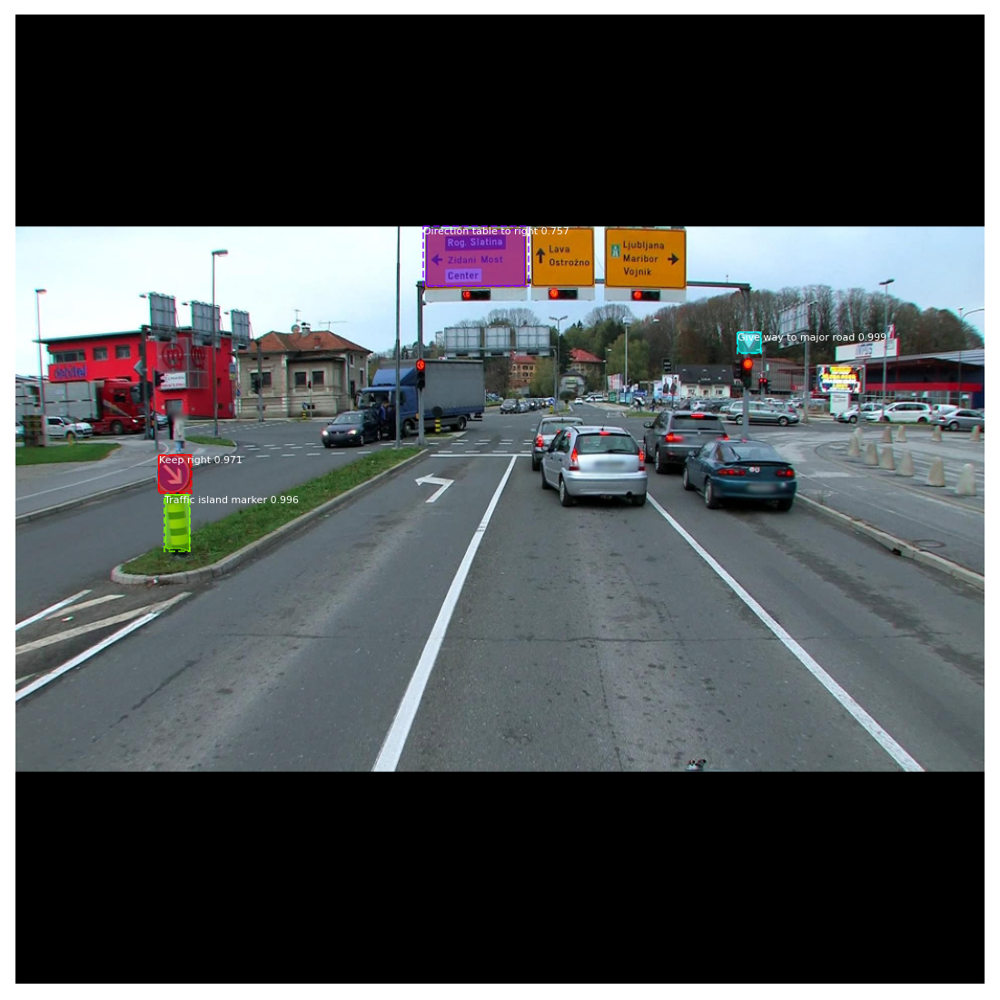

In [60]:
results = model.detect([image], verbose=0)
r = results[0]

visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], class_names_bg(), r['scores'], figsize=(20, 20))

* <font color=darkblue> **Observation**<font>

Comparing the prediction with ground truth indicates that the accuracy of the model is acceptable.

<hr />

## <font color=darkblue>**8.2. Some Predictions** <font>
To have a better visualization, we are going to add each class icon beside the predicted bounding boxes. In this case, we can compare the prediction icon with the original sign in the image to simply ensure that the predicted sign is correct rather than comparing the bounding box label.

In [ ]:
def prediction(image_path, with_distance = False):

    if isinstance(image_path, str):
        image = load_image(image_path)
    else:
        image = image_path
    height, width, _ = image.shape
    results = model.detect([image], verbose=0)

    boxes  = results[0]['rois']   # [num_instance, (y1, x1, y2, x2, class_id)] in image coordinates.
    masks  = results[0]['masks']  # masks: [height, width, num_instances]
    class_ids = results[0]['class_ids'] # [num_instances]
    scores =   results[0]['scores'] # confidence scores for each box

    masked_image = image.astype(np.uint32).copy()
    alert_flag = 0
    for i in range(boxes.shape[0]):

        y1, x1, y2, x2 = boxes[i]
        box_w = x2 - x1
        box_h = y2 - y1
        class_row = class_names[class_names['class_id'] == class_ids[i]]
        color = make_tuple(class_row.iloc[0,4])
        color_prep = np.array(color) * 255.0
        caption_position_x = x2+15
        caption_position_y = y1+(box_h//2)

        # Mask
        masked_image = visualize.apply_mask(image, masks[:, :, i], color=color)
        
        # Insert corresponding icon
        icon_path = os.path.join(CLASSES, f'{class_ids[i]}.png')
        if os.path.exists(icon_path):
            icon = load_image(icon_path)
            icon = skimage.transform.resize(icon, (box_h, box_w) , anti_aliasing=True)
            x_start = x2 + 10
            x_end = x_start +(x2-x1)
            
            if x_end > width:
                caption_position_x -= box_w - 35
                x_start = x1 - box_w - 10
                x_end = x_start +(x2-x1)

            for c in range(0, 3):
                image[y1:y2, x_start:x_end , c] = icon[:, :, c]*255.0
            caption_position_x += box_w
    
        # border
        cv2.rectangle(image, 
                      (x1, y2), 
                      (x2, y1), 
                      color_prep, 
                      thickness=2)

        # caption
        score = scores[i] if scores is not None else None
        label = class_names[class_names['class_id'] == class_ids[i]].iloc[0,3]
        caption = "{} {:.2f}".format(label, score) if score else label
      
        cv2.putText(image, 
                    caption, 
                    (caption_position_x, caption_position_y), 
                    cv2.FONT_HERSHEY_SIMPLEX, 
                    0.8, 
                    color_prep, 
                    thickness=2, 
                    lineType=cv2.LINE_AA)

        ######_______________________Distance ________________________#####
        if with_distance and class_ids[i] in alerts.keys():
            H, bev_h, bev_w, pix_per_meter = homography(image, False)
            ego_bev_xy = bev_w // 2, bev_h  # Ego position in birdeye view

            # Draw ground midpoint markers
            ground_mid_box = (int(x1 + box_w // 2), int(y1 + box_h))

            cv2.circle(image, 
                       center=ground_mid_box, 
                       radius=5,
                       color=color_prep, 
                       thickness=cv2.FILLED)

            ground_mid = (int(x1 + box_w // 2), int(y1 + box_h + (box_h * alerts[class_ids[i]]['rate'])))

            midpoint = np.concatenate([ground_mid, np.ones(1)])

            midpoint_warped = H @ midpoint
            midpoint_warped /= midpoint_warped[-1]
            midpoint_warped = midpoint_warped[:-1]

            ground_mid_warped = tuple(int(a) for a in midpoint_warped)

            x, y = ground_mid_warped
            delta = [x, y] - np.asarray(ego_bev_xy)
            dist_pix = np.sqrt(np.sum(delta ** 2))

            dist_meter = dist_pix / pix_per_meter

            if dist_meter <= 12:
                # Draw distance lines            
                cv2.line(image, 
                        ground_mid_box, 
                        (image.shape[1] // 2, 
                        image.shape[0]), 
                        color=(255, 255, 255), 
                        thickness=2)

                # Draw distance text
                x, y = ground_mid_box
                cv2.putText(image, 
                            f'{dist_meter:.02f}m', 
                            (x1-120, y1+box_h//2), 
                            cv2.FONT_HERSHEY_SIMPLEX, 
                            1, 
                            color=(255, 255, 255), 
                            thickness=3,
                            lineType=cv2.LINE_AA)
            
            # Feedback
            feedback = None
            if dist_meter > 5 and dist_meter <= 12:
                feedback = alerts[class_ids[i]]['feedback'][0]
            elif dist_meter <=5 and dist_meter >=1:
                feedback = alerts[class_ids[i]]['feedback'][1]
            elif dist_meter < 1 and len(alerts[class_ids[i]]['feedback']) == 3:
                feedback = alerts[class_ids[i]]['feedback'][2]

            if feedback is not None:
                alert_flag += 60
                cv2.putText(image, 
                        feedback, 
                        (width // 3, height- 300 + alert_flag), 
                        cv2.FONT_HERSHEY_SIMPLEX, 
                        1.2, 
                        color=alerts[class_ids[i]]['color'], 
                        thickness=2)

        
    return masked_image.astype(np.uint8)

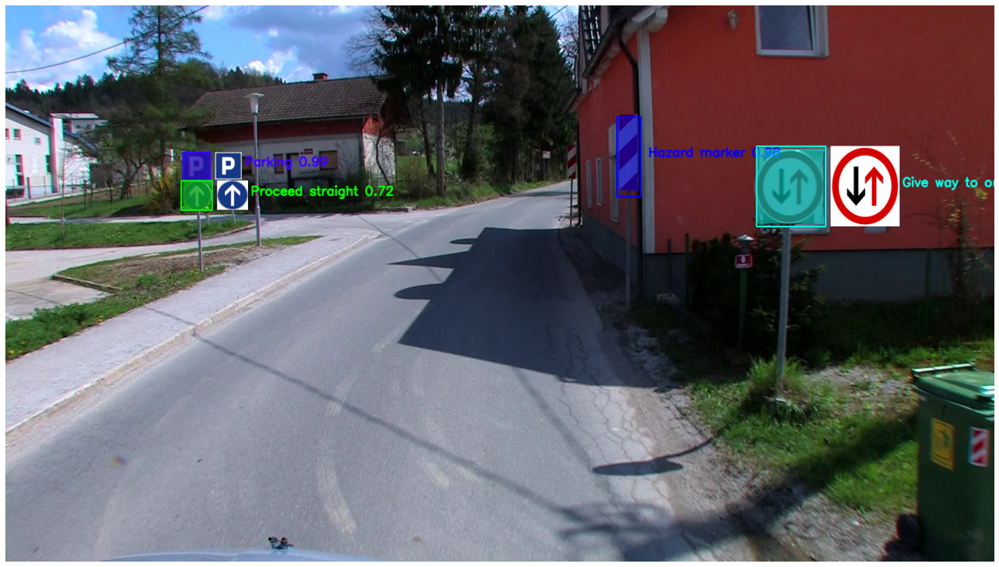

In [ ]:
image = prediction(os.path.join(DATASET_PATH, '0001319.jpg'))

plt.figure(figsize=(23, 23))
plt.axis('off')
plt.imshow(image)

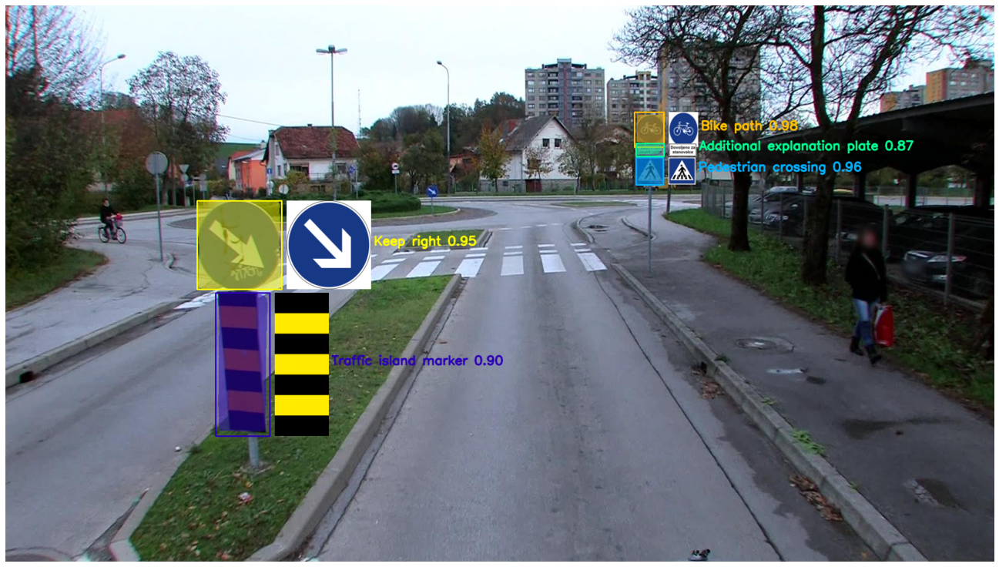

In [ ]:
image = prediction(os.path.join(DATASET_PATH, '0000005.jpg'))

plt.figure(figsize=(23, 23))
plt.axis('off')
plt.imshow(image)

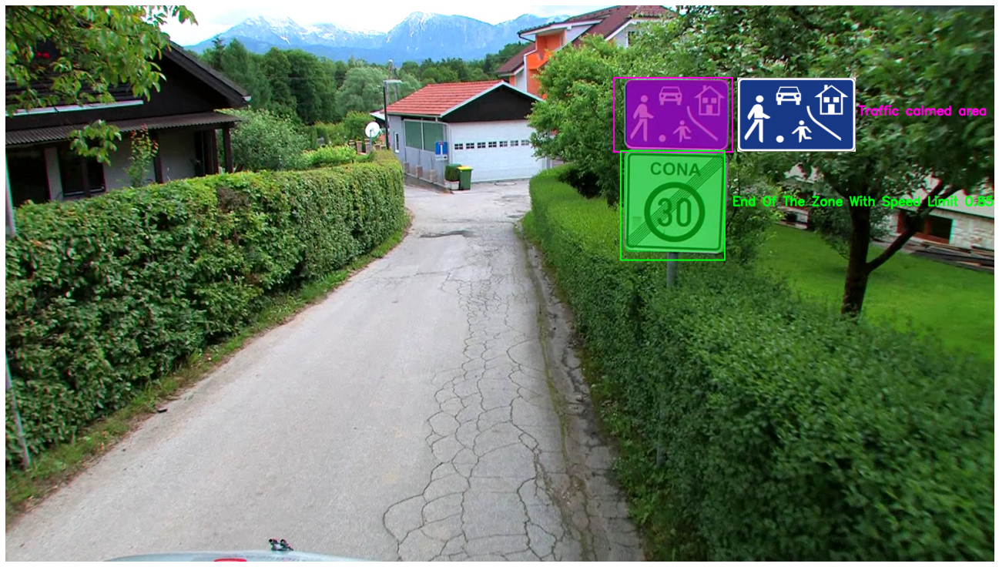

In [ ]:
image = prediction(os.path.join(DATASET_PATH, '0004721.jpg'))

plt.figure(figsize=(23, 23))
plt.axis('off')
plt.imshow(image)

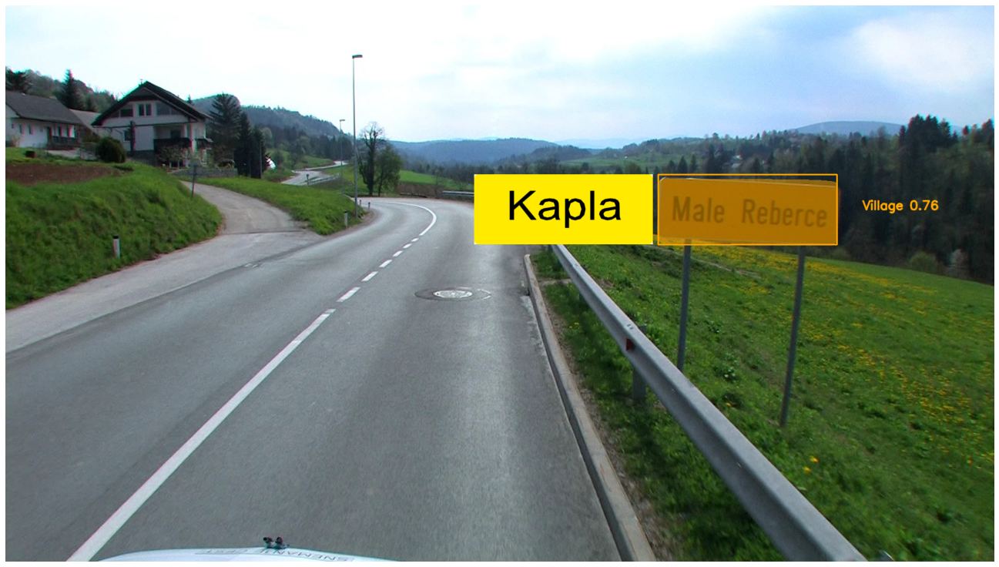

In [ ]:
image = prediction(os.path.join(DATASET_PATH, '0002183.jpg'))

plt.figure(figsize=(23, 23))
plt.axis('off')
plt.imshow(image)

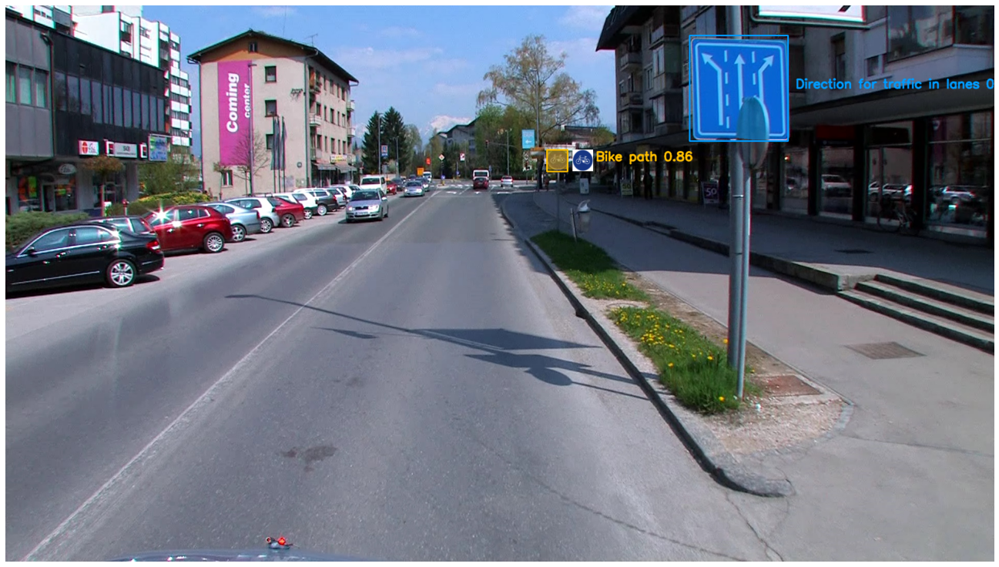

In [ ]:
image = prediction(os.path.join(DATASET_PATH, '0002008.jpg'))

plt.figure(figsize=(23, 23))
plt.axis('off')
plt.imshow(image)

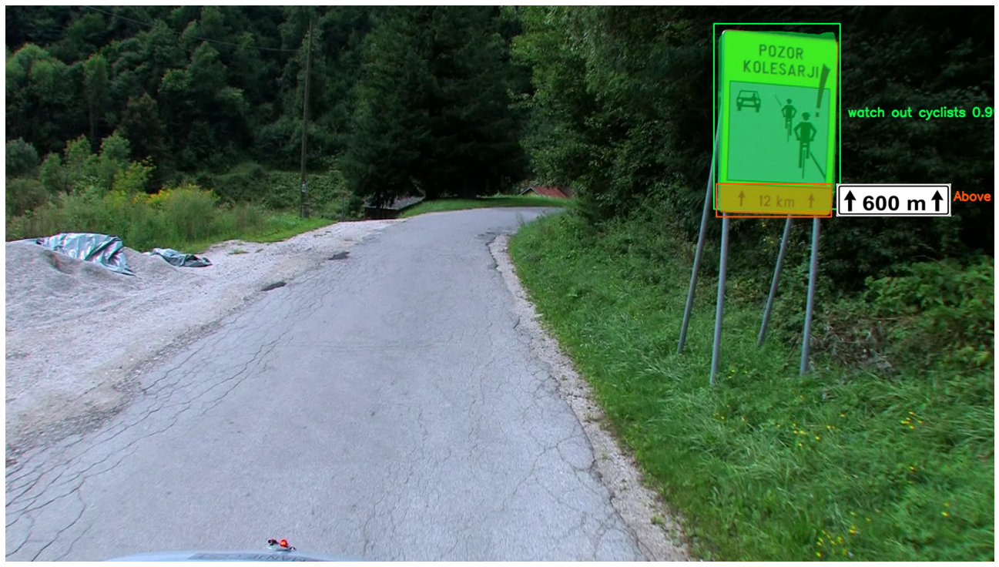

In [ ]:
image = prediction(os.path.join(DATASET_PATH, '0003614.jpg'))

plt.figure(figsize=(23, 23))
plt.axis('off')
plt.imshow(image)

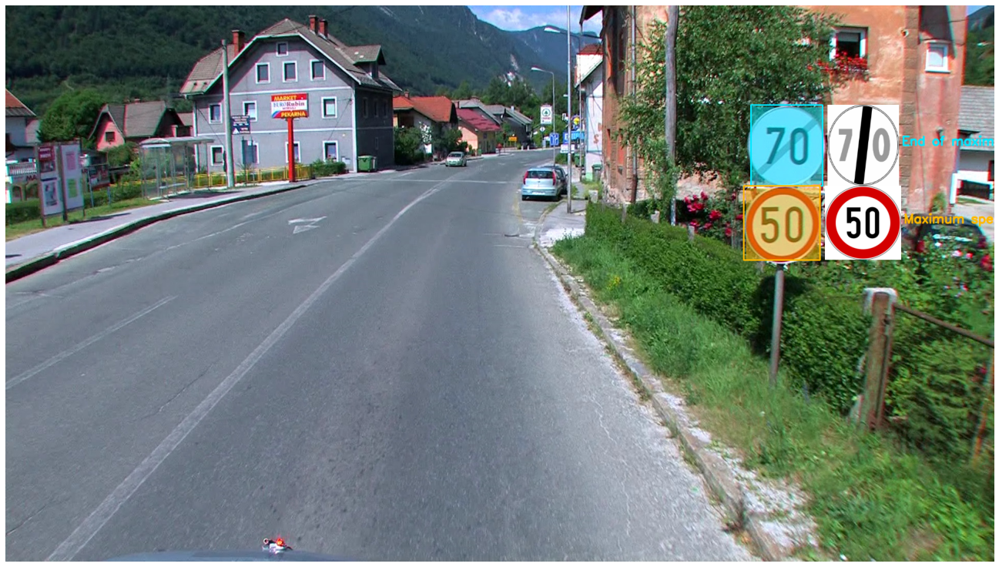

In [ ]:
image = prediction(os.path.join(DATASET_PATH, '0002837.jpg'))

plt.figure(figsize=(23, 23))
plt.axis('off')
plt.imshow(image)

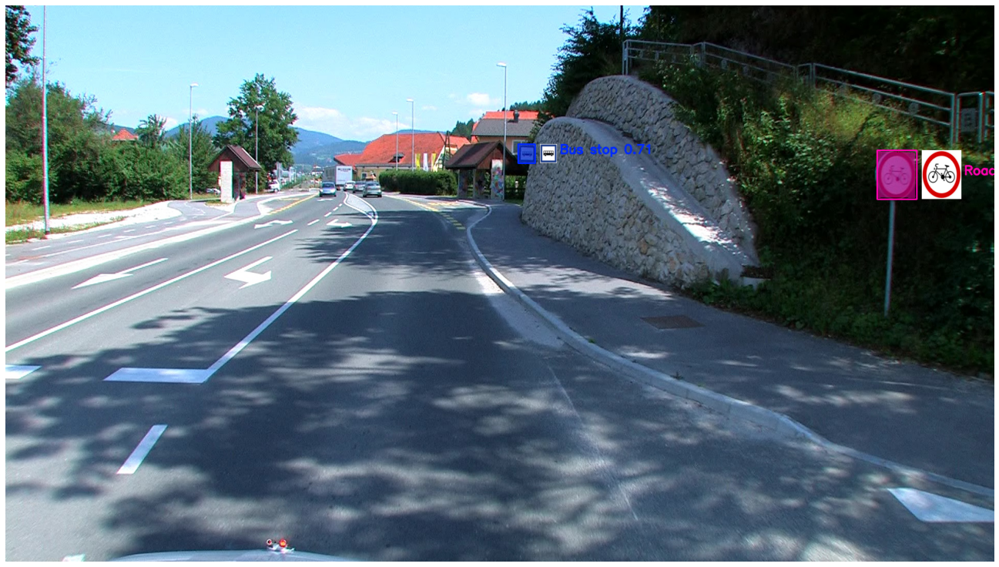

In [ ]:
image = prediction(os.path.join(DATASET_PATH, '0003547.jpg'))

plt.figure(figsize=(23, 23))
plt.axis('off')
plt.imshow(image)

## <font color=darkblue> **8.3. Evaluation**<font>
To evaluate the model, despite the visual representation that we have shown so far, we are going to compute the  `Average Precision` at a set `IoU` threshold. The default value for the `Intersection over Union (IoU)` threshold is 0.5.

There are some other metrics as follows:
- precisions: List of precisions at different class score thresholds.
- recalls: List of recall values at different class score thresholds.
- overlaps: [pred_boxes, gt_boxes] IoU overlaps.

We are going to consider only the Mean Average Precision metric in our evaluation function.

In [ ]:
def evaluation(dataset, num_samples, config, model):
    
    image_ids = np.random.choice(dataset.image_ids, num_samples)    
    APs = []
    for image_id in image_ids:
        # Load image and ground truth data
        image, image_meta, gt_class_id, gt_bbox, gt_mask = mrcnn.model.load_image_gt(dataset, 
                                                                                     config,
                                                                                     image_id, 
                                                                                     use_mini_mask=False)
        molded_images = np.expand_dims(mrcnn.model.mold_image(image, config), 0)
        # Run object detection
        results = model.detect([image], verbose=0)
        r = results[0]
        # Compute evaluation metrics
        AP, precisions, recalls, overlaps = mrcnn.utils.compute_ap(gt_bbox, 
                                                                   gt_class_id, 
                                                                   gt_mask,
                                                                   r["rois"], 
                                                                   r["class_ids"], 
                                                                   r["scores"], 
                                                                   r['masks'])
        APs.append(AP)
        
    return np.mean(APs)

###<font color=darkblue>**8.3.1. Mean Average Precision on Training Set**<font>
As we have tried random samples in our function for the evaluation pipeline, the mAP value could be different as a result in each run.

In [ ]:
mAP_training = evaluation(train_set, 10, inference_config, model)
print('mAP on training set is: ', mAP_training)

mAP on training set is:  0.8700000017881393


###<font color=darkblue>**8.3.2. Mean Average Precision on Test Set**<font>
Again like the training set in which we have random samples in the function for the evaluation, the mAP value could be different as a result in each run.

In [ ]:
mAP_test = evaluation(test_set, 10, inference_config, model)
print('mAP on test set is: ', mAP_test)

mAP on test set is:  0.8333333373069763


#<font color=darkblue>**9. Distance estimation and Feedback**<font>

we’ll try to assess the distance to the detected traffic signs from the viewpoint. 

Once we get the bounding box and midpoint of its bottom edge, using perspective transform, we can map the original image to the `bird's view`. 

We do not need to warp the whole image, but just recalculate the position of the single on the warped image. On that image, there is a direct correlation between the pixel position and distance in meters, so the distance between the calculated position of the midpoint and the bottom of the image multiplied by the number of meters per pixel represents the distance between our viewpoint and the traffic sign that we have detected. 

**Later on once we have the distance per frame,
by looking at how that distance changes, we will have a feedback message to the driver as a guideline during the driving.**

##<font color=darkblue>**9.1 Bird's eye view**<font>
As mentioned above, we are going to take a top view of our image which is known as a bird's eye view in the literature. 
To provide this view we need to define the homography function.
In the field of computer vision, any two images of the same planar surface in space are related by homography (assuming a pinhole camera model). This has many practical applications, such as image rectification, image registration, or camera motion—rotation and translation—between two images. Briefly, the planar homography relates to the transformation between two planes (up to a scale factor).

In [ ]:
def homography(frame, auto_show=False):
    # Choose trapezoid points in frontal view
    height, width = frame.shape[:-1]
    y0, y1 = 450, height 
    # y0, y1 = int(height * 0.6), height 
    # int(height * 0.6)
    x_off = 50  
    a = 0, y1
    b = width // 2 - x_off, y0
    c = width // 2 + x_off, y0
    d = width, y1

    trapezoid = np.expand_dims(np.asarray([a, b, c, d]), 1).astype(np.int32)

    trapezoid_img = cv2.fillPoly(np.zeros(shape=(height, width, 3)),[trapezoid], color=(0, 0, 255))

    # In real world, the trapezoid is a rectangle with the following measures
    ab_meters, ad_meters = 15 , 4

    # Measure of the bird's eye image
    pix_per_meter = 40
    bev_w = ad_meters * pix_per_meter
    bev_h = ab_meters * pix_per_meter
    xoff = 500
    dst_points = np.asarray([(xoff + 0, bev_h),
                                (xoff + 0, 0),
                                (xoff + bev_w, 0),
                                (xoff + bev_w, bev_h)])
    bev_w += (2 * xoff)

    H, mask = cv2.findHomography(trapezoid, dst_points)

    if auto_show:
        # Warp according to currently found homography
        birdeye = cv2.warpPerspective(frame, H, (bev_w, bev_h))

        alpha = 0.2
        beta = 1 - alpha

        image_show = np.uint8(trapezoid_img * alpha + frame * beta)

        ratio = image_show.shape[0] / birdeye.shape[0]
        warped_show = cv2.resize(birdeye, dsize=None, fx=ratio, fy=ratio)
        cat_show = np.concatenate([image_show, warped_show], axis=1)
        cat_show = cv2.resize(cat_show, dsize=None, fx=0.4, fy=0.4)
        cv2_imshow(cat_show)
        return

    return H, bev_h, bev_w, pix_per_meter

<font color=darkgreen>**An example of bird's eye view**<font>

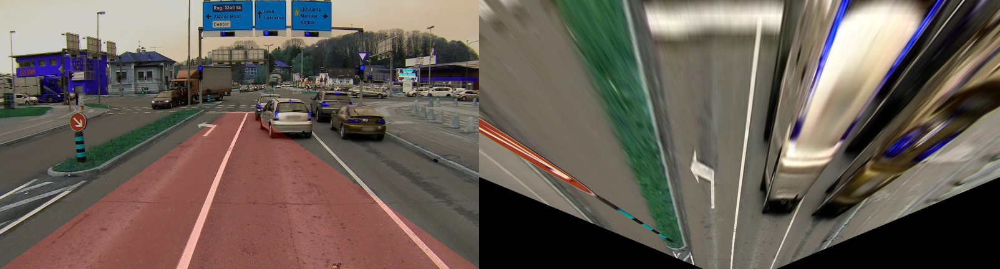

In [ ]:
frame = load_image('/content/drive/MyDrive/sign_detection/dataset/0000002.jpg')

homography(frame, True)

## <font color=darkblue>**9.2. Some examples for distance estimation**<font>

We want to provide a feedback message for the driver, but of course, we do not want to distract them too much by giving too much feedback.
Thus, we have decided to have a feedback system in which a message will be shown to the driver only when some important traffic signs have been detected.


To do this, in the following:
- We will define some important traffic signs as **`alerts`**.
- we will estimate the distance between our viewpoint and these signs.
- based on the measured distance, we will send a message as feedback to the driver as a guideline. This feedback could improve the performance of the driver during the driving.
- we also define a general pipeline for our prediction.


In [ ]:
alerts = {
    38:{'rate':3,'color': (255, 255, 255), 
        'feedback':[
            'You are getting closer to the give way traffic sign!!', 'WAIT !!! and pay attention to the major road!! '
        ]}, # Give way to major road
    187:{'rate':0.1,'color': (255, 255, 255), 'feedback':[
        'Island marker!', 'Island marker! in less than 5 meters'
    ]}, # Traffic island marker
    100:{'rate':3,'color': (255, 255, 255), 'feedback':[
        'you are getting closer to the Emergency station', 'Emergency station on less than 5 meters'
    ]}, # Emergency station
    64:{'rate':4,'color': (255, 255, 255), 'feedback':[
        'Danger of crashing with the bicycle', 'Decrease the speed!!!! Pay attention to Bike Path!!!', 'You are safe now, if you want, increase your speed. :)'
    ]}, # Bike path
    137:{'rate':4,'color': (255, 0, 0), 'feedback':[
        'Danger of crashing with the Pedestrian', 'Decrease the speed!!!! Pay attention to Pedestrian!!!', 'You are safe now, if you want, increase your speed.'
    ]}, # Pedestrian crossing
    44:{'rate':3,'color': (255, 0, 0), 'feedback':[
        'You are getting closer to the stop sign', 'OK decrease the speed and stop the car!', 'STOP STOP STOP!!! POOOOOOFFFF (you are crashed)'
    ]}, # Stop
    124:{'rate':4,'color': (255, 255, 255), 'feedback':[
        'there is a parking lot in less than 10 meters', 'there is a parking lot very close to you'
    ]}, # Parking
    185:{'rate': 1.1,'color': (255, 255, 255), 'feedback':[
        'Hazard Marker', 'pay attention to the change in the direction of travel'
    ]}, # Hazard marker	
    59:{'rate': 2.2,'color': (255, 255, 255), 'feedback':[
        'Give way to oncoming traffic in the road', 'Give way to oncoming traffic!'
    ]}, # Give way to oncoming traffic
    40:{'rate': 3,'color': (255, 255, 255), 'feedback':[
        'Road are closed for bikes!', 'Road are closed for bikes!!'
    ]}, # Road closed to bicycles
    135: {'rate': 3.9,'color': (255, 255, 255), 'feedback':[
        'There is a bus station in front of you, danger of crashing!', 'BUS station close to you, decrease your speed buddy!'
    ]}, # Bus stop	
    55: {'rate': 2,'color': (200, 0, 0), 'feedback':[
        'if you are driving fast, decrease the speed!', 'The maximum speed is 50!'
    ]}, # Maximum speed 50
    53: {'rate': 4,'color': (200, 0, 0), 'feedback':[
        'if you are driving fast, decrease the speed!', 'The maximum speed is 30!'
    ]}, # Maximum speed 30
}

<font color=darkgreen>**Some examples with estimated distance**<font>

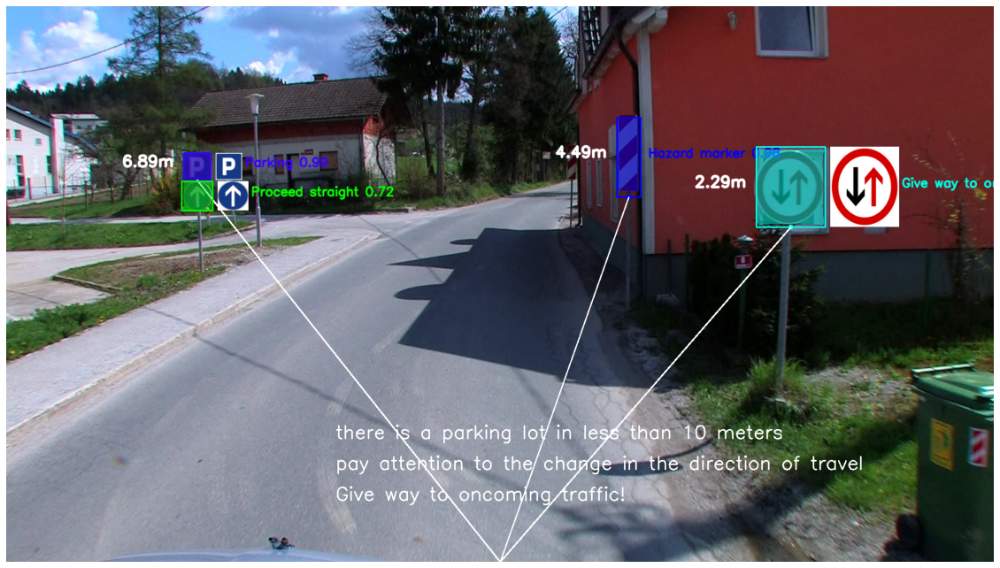

In [ ]:
image_path = os.path.join(DATASET_PATH, '0001319.jpg')

plt.figure(figsize=(20,20))
plt.axis('off')
plt.imshow(prediction(image_path, with_distance=True))

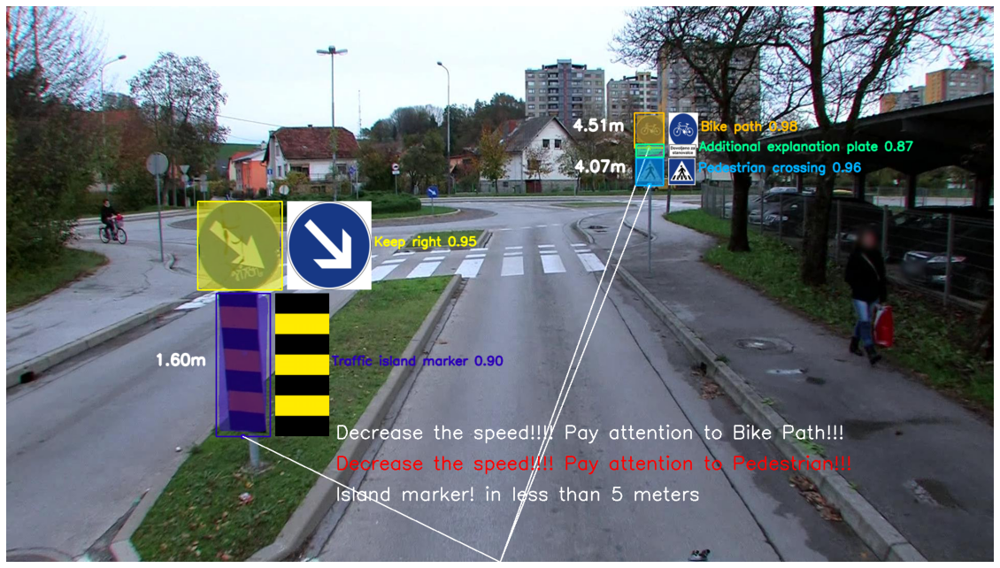

In [ ]:
image_path = os.path.join(DATASET_PATH, '0000005.jpg')

plt.figure(figsize=(20,20))
plt.axis('off')
plt.imshow(prediction(image_path, with_distance=True))

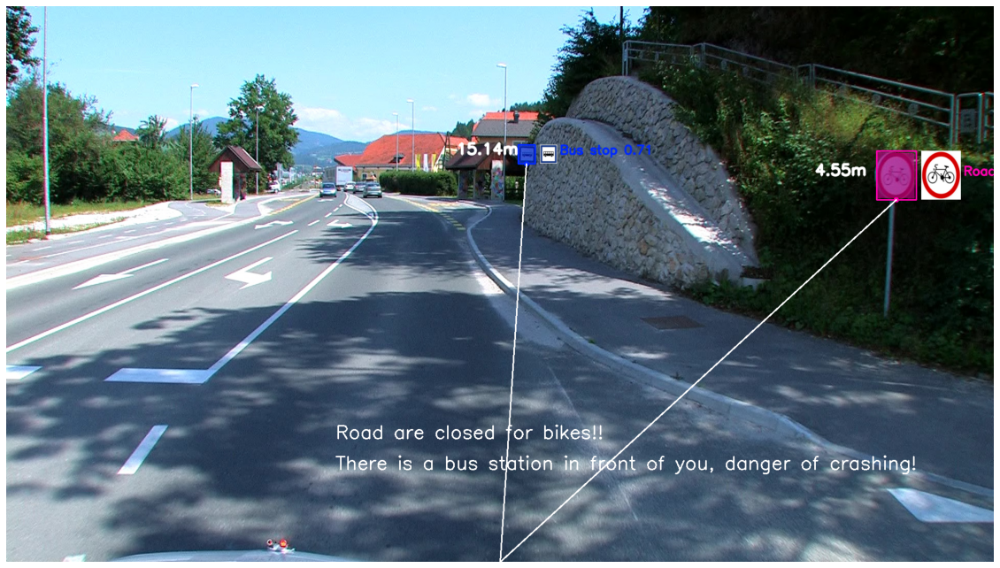

In [ ]:
image_path = os.path.join(DATASET_PATH, '0003547.jpg')

plt.figure(figsize=(20,20))
plt.axis('off')
plt.imshow(prediction(image_path, with_distance=True))

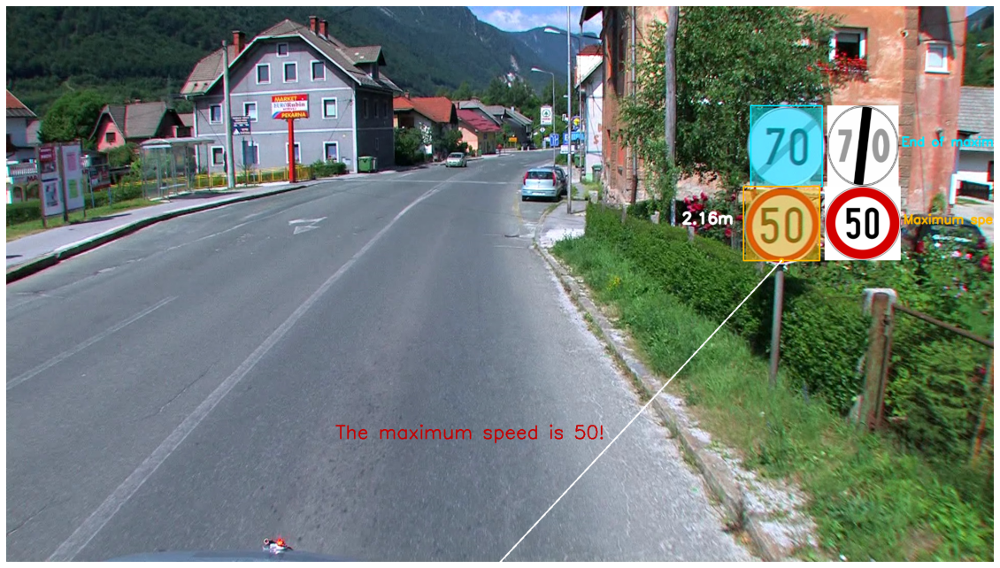

In [ ]:
image_path = os.path.join(DATASET_PATH, '0002837.jpg')

plt.figure(figsize=(20,20))
plt.axis('off')
plt.imshow(prediction(image_path, with_distance=True))

## <font color=darkblue>**10. General Pipeline on Videos**<font>


In [ ]:
import imageio
import cv2

video_path = 'path/to/your/video'
frames_path = '/content/frames'
destination = os.path.join(PROJECT_PATH, 'final.mp4')

vid = imageio.get_reader(video_path)

for num, frame in enumerate(vid.iter_data()):
    image = prediction(frame, with_distance=True)
    if not os.path.exists(frames_path):
        os.mkdir(frames_path)

    skimage.io.imsave(os.path.join(frames_path, f'{num}.jpeg'), image)

In [ ]:
def make_video(outvid, images=None, fps=30, size=None,
               is_color=True, format="FMP4"):
    """
    Create a video from a list of images.
 
    @param      outvid      output video
    @param      images      list of images to use in the video
    @param      fps         frame per second
    @param      size        size of each frame
    @param      is_color    color
    @param      format      see http://www.fourcc.org/codecs.php
    @return                 see http://opencv-python-tutroals.readthedocs.org/en/latest/py_tutorials/py_gui/py_video_display/py_video_display.html
 
    The function relies on http://opencv-python-tutroals.readthedocs.org/en/latest/.
    By default, the video will have the size of the first image.
    It will resize every image to this size before adding them to the video.
    """
    from cv2 import VideoWriter, VideoWriter_fourcc, imread, resize
    fourcc = VideoWriter_fourcc(*format)
    vid = None
    for image in images:
        if not os.path.exists(image):
            raise FileNotFoundError(image)
        img = imread(image)
        if vid is None:
            if size is None:
                size = img.shape[1], img.shape[0]
            vid = VideoWriter(outvid, fourcc, float(fps), size, is_color)
        if size[0] != img.shape[1] and size[1] != img.shape[0]:
            img = resize(img, size)
        vid.write(img)
    vid.release()
    return vid

In [ ]:
import glob
import os

images = list(glob.iglob(os.path.join(frames_path, '*.*')))
# Sort the images by integer index
images = sorted(images, key=lambda x: int(os.path.split(x)[1][:-5]))

make_video(destination, images, 30)

<VideoWriter 0x7fc3429dae10>